In [1]:
import pandas as pd
import numpy as np

In [3]:
df = pd.read_csv("df_indexes_gold.csv", index_col=0)
df.head()

,Open Time,Open,High,Low,Close,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ
0,2015-10-11,246.3,249.50,246.30,249.50,3021.12,104550.0,2081.72,2077.19,1,1149.4,1149.4,17724.13,17758.21
1,2015-10-12,249.5,249.50,247.60,247.60,9493.89,134410.0,2052.23,2047.93,1,1130.3,1130.3,17493.17,17574.75
2,2015-10-13,247.6,252.87,245.75,250.00,12875.40,134878.0,2003.69,2015.00,1,1231.7,1231.7,17113.55,17081.89
3,2015-10-14,250.0,254.75,250.00,253.00,30115.77,141985.0,1994.24,2003.66,1,1243.6,1243.6,17079.08,16924.75
4,2015-10-15,253.0,258.98,253.00,255.26,50535.45,153495.0,2023.86,1996.47,1,1251.4,1251.4,16944.86,17141.75


In [7]:
df['Open Time'] = pd.to_datetime(df['Open Time'])

In [87]:
eth = pd.read_csv("ETH_day.csv")
eth.head()

,Date,Symbol,Open,High,Low,Close,Volume ETH,Volume USD
0,2020-04-15,ETHUSD,158.61,158.61,158.61,158.61,0.00,0.00
1,2020-04-14,ETHUSD,156.97,162.15,155.74,158.61,18061.58,2872210.44
2,2020-04-13,ETHUSD,158.56,159.51,150.12,156.97,15698.32,2416728.28
3,2020-04-12,ETHUSD,158.66,165.37,155.21,158.56,12877.33,2082804.05
4,2020-04-11,ETHUSD,158.26,161.49,154.25,158.66,13761.72,2172914.57


In [88]:
eth['Open Time'] = pd.to_datetime(eth['Date'])

In [89]:
eth = eth[['Open Time', 'Open', 'High', 'Low', 'Close', 'Volume USD']]
eth.rename(columns={'Volume USD':'Volume'}, inplace=True)

In [27]:
from binance.client import Client
from datetime import datetime, timedelta
import time
import dateparser
import pytz
import json

import math  


In [14]:
def binanceDataFrame(klines):
  df = pd.DataFrame(klines.reshape(-1,12), dtype=float, columns=['Open Time',
                                                                 'Open',
                                                                 'High',
                                                                 'Low',
                                                                 'Close',
                                                                 'Volume',
                                                                 'Close Time',
                                                                 'Quote asset volume',
                                                                 'Number of trades',
                                                                 'Taker buy base asset volume',
                                                                 'Taker buy quote asset volume',
                                                                 'Can be ignored']);

  df['Open Time'] = pd.to_datetime(df['Open Time'], unit='ms')
  df['Close Time'] = pd.to_datetime(df['Close Time'], unit='ms')

  return df

In [15]:
def date_to_miliseconds(date_str):
  epoch = datetime.utcfromtimestamp(0).replace(tzinfo=pytz.utc)
  d = dateparser.parse(date_str)
  if d.tzinfo is None or d.tzinfo.utcoffset(d) is None:
    d = d.replace(tzinfo=pytz.utc)

  #return difference in time
  return int((d - epoch).total_seconds()*1000.0)

In [16]:
def interval_to_miliseconds(interval):
  ms = None
  seconds_per_unit = {
      "m": 60,
      "h": 60 * 60,
      "d": 24 * 60 * 60,
      "w": 7 * 24 * 60 * 60,
  }

  unit = interval[-1]
  if unit in seconds_per_unit:
    try:
      ms = int(interval[:-1]) * seconds_per_unit[unit] * 1000
    except:
      pass

  return ms

In [17]:
def get_historical_klines(symbol, interval, start_str, end_str=None):
  output_data=[]
  limit=500
  timeFrame = interval_to_miliseconds(interval)
  start_ts = date_to_miliseconds(start_str)
  end_ts = None
  if end_str:
    end_ts = date_to_miliseconds(end_str)
  
  idx = 0
  symbol_existed = False
  while True:
    #fetch
    temp_data = client.get_klines(symbol = symbol, 
                                  interval = interval, 
                                  limit = limit, 
                                  startTime = start_ts, 
                                  endTime = end_ts)
    
    if not symbol_existed and len(temp_data):
      symbol_existed = True

    if symbol_existed:
      output_data += temp_data

      start_ts = temp_data[len(temp_data) - 1][0] + timeFrame

    idx += 1

    if len(temp_data)<limit:
      break

    if idx % 3 == 0:
      time.sleep(1)

  return output_data

In [20]:
api_key = 'xBLnmNJc6cip89NuJnA7MfVv6OmMeG9q8QixeTB6VJCsPOxHHx8rTR7AusIHnKyb'
api_secret = 'sWvFLrO3qNBpX01jJWF5DuH0d8hdxvVNIIOrx5TQiocI0kFLFhi0AWI1lL3KThtj'
client = Client(api_key, api_secret)

In [80]:
%%time
symbol = "ETHUSDT"
start = "16 Apr, 2020"
interval = Client.KLINE_INTERVAL_1DAY
klines = get_historical_klines(symbol,interval,start)
klines = np.array(klines)
df_eth_last = binanceDataFrame(klines)

Wall time: 1.24 s


In [81]:
df_eth_last.head()

,Open Time,Open,High,Low,Close,Volume,Close Time,Quote asset volume,Number of trades,Taker buy base asset volume,Taker buy quote asset volume,Can be ignored
0,2020-04-16,152.74,174.79,148.33,172.29,1.647208e+06,2020-04-16 23:59:59.999000064,2.736392e+08,389854.0,830355.78324,1.378978e+08,0.0
1,2020-04-17,172.31,174.96,168.31,170.69,7.235378e+05,2020-04-17 23:59:59.999000064,1.235535e+08,191289.0,352005.34180,6.012189e+07,0.0
2,2020-04-18,170.61,189.54,170.48,187.40,1.127296e+06,2020-04-18 23:59:59.999000064,2.031322e+08,286172.0,569708.87703,1.026967e+08,0.0
3,2020-04-19,187.40,188.35,175.75,180.03,9.957596e+05,2020-04-19 23:59:59.999000064,1.814158e+08,270668.0,478833.69271,8.722725e+07,0.0
4,2020-04-20,180.02,186.46,166.70,170.20,1.547822e+06,2020-04-20 23:59:59.999000064,2.738545e+08,365589.0,745586.67414,1.319187e+08,0.0


In [82]:
df_eth_prev = pd.read_csv(r'EtherPriceHistory(USD).csv')

In [83]:
df_eth_prev.tail()

,Date(UTC),UnixTimeStamp,Value
1159,10/1/2018,1538352000,230.89
1160,10/2/2018,1538438400,225.41
1161,10/3/2018,1538524800,219.97
1162,10/4/2018,1538611200,221.76
1163,10/5/2018,1538697600,227.90


In [85]:
df_eth_prev['Open Time'] = pd.to_datetime(df_eth_prev[r'Date(UTC)'])

In [86]:
df_eth_last = df_eth_last[['Open Time', 'Close']]
df_eth_prev = df_eth_prev[['Open Time', 'Value']]
df_eth_prev.rename(columns={'Value':'Close'}, inplace=True)

c:\users\juanl\appdata\local\programs\python\python38\lib\site-packages\pandas\core\frame.py:4438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [92]:
eth = pd.concat([eth, df_eth_last])

In [93]:
eth = pd.concat([eth, df_eth_prev])

In [94]:
eth = eth.sort_values(by='Open Time')
eth.head()

,Open Time,Open,High,Low,Close,Volume
0,2015-07-30,NaN,NaN,NaN,0.0,NaN
1,2015-07-31,NaN,NaN,NaN,0.0,NaN
2,2015-08-01,NaN,NaN,NaN,0.0,NaN
3,2015-08-02,NaN,NaN,NaN,0.0,NaN
4,2015-08-03,NaN,NaN,NaN,0.0,NaN


In [95]:
eth = eth.dropna(axis=1)

In [97]:
eth = eth.drop_duplicates(subset=['Open Time'])

In [98]:
eth.tail()

,Open Time,Close
368,2021-04-19,2161.12
369,2021-04-20,2330.03
370,2021-04-21,2357.06
371,2021-04-22,2397.94
372,2021-04-23,2228.77


In [99]:
df_eth = df.merge(eth, on='Open Time', how='left', suffixes=('_btc','_eth'))

In [100]:
df_eth.isna().sum()

Open Time             0
Open                  0
High                  0
Low                   0
Close_btc             0
Volume                0
NumberTransactions    0
Close SP500           0
Open SP500            0
halving               0
Close Gold            0
Open Gold             0
OpenDJ                0
CloseDJ               0
Close_eth             0
dtype: int64

In [102]:
df_eth[df_eth.Close_eth.isna()]

,Open Time,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth


In [103]:
df_eth.to_csv('df_indexes_gold_eth.csv')

In [104]:
df_eth.corr()

,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth
Open,1.000000,0.999305,0.998788,0.998617,0.026750,0.842397,0.774783,0.779131,0.660857,0.571550,0.575014,0.711572,0.707788,0.919708
High,0.999305,1.000000,0.998662,0.999427,0.032724,0.846551,0.773268,0.777527,0.659525,0.569323,0.572833,0.709733,0.706028,0.920838
Low,0.998788,0.998662,1.000000,0.999138,0.011956,0.835859,0.776226,0.780583,0.663989,0.574603,0.578147,0.712480,0.708726,0.918170
Close_btc,0.998617,0.999427,0.999138,1.000000,0.024030,0.842797,0.774551,0.778765,0.662341,0.571732,0.575210,0.710537,0.706894,0.920012
Volume,0.026750,0.032724,0.011956,0.024030,1.000000,-0.164348,-0.035034,-0.035626,-0.228312,-0.152432,-0.152111,0.058259,0.058708,0.199310
NumberTransactions,0.842397,0.846551,0.835859,0.842797,-0.164348,1.000000,0.705674,0.709172,0.767180,0.639348,0.640950,0.589212,0.585307,0.717076
Close SP500,0.774783,0.773268,0.776226,0.774551,-0.035034,0.705674,1.000000,0.998829,0.683955,0.805762,0.806417,0.970832,0.971341,0.668378
Open SP500,0.779131,0.777527,0.780583,0.778765,-0.035626,0.709172,0.998829,1.000000,0.686786,0.805593,0.806334,0.971318,0.969457,0.672635
halving,0.660857,0.659525,0.663989,0.662341,-0.228312,0.767180,0.683955,0.686786,1.000000,0.789847,0.789774,0.545065,0.541342,0.538853
Close Gold,0.571550,0.569323,0.574603,0.571732,-0.152432,0.639348,0.805762,0.805593,0.789847,1.000000,0.998549,0.694821,0.693893,0.433628


## XGBoost

In [150]:
df_eth.corr()

,Unnamed: 0,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth
Unnamed: 0,1.000000,0.656861,0.654563,0.660284,0.656900,-0.056267,0.607682,0.923243,0.923394,0.651195,0.821199,0.822265,0.910292,0.909261,0.515011
Open,0.656861,1.000000,0.999305,0.998788,0.998617,0.026750,0.842397,0.774783,0.779131,0.660857,0.571550,0.575014,0.711572,0.707788,0.919708
High,0.654563,0.999305,1.000000,0.998662,0.999427,0.032724,0.846551,0.773268,0.777527,0.659525,0.569323,0.572833,0.709733,0.706028,0.920838
Low,0.660284,0.998788,0.998662,1.000000,0.999138,0.011956,0.835859,0.776226,0.780583,0.663989,0.574603,0.578147,0.712480,0.708726,0.918170
Close_btc,0.656900,0.998617,0.999427,0.999138,1.000000,0.024030,0.842797,0.774551,0.778765,0.662341,0.571732,0.575210,0.710537,0.706894,0.920012
Volume,-0.056267,0.026750,0.032724,0.011956,0.024030,1.000000,-0.164348,-0.035034,-0.035626,-0.228312,-0.152432,-0.152111,0.058259,0.058708,0.199310
NumberTransactions,0.607682,0.842397,0.846551,0.835859,0.842797,-0.164348,1.000000,0.705674,0.709172,0.767180,0.639348,0.640950,0.589212,0.585307,0.717076
Close SP500,0.923243,0.774783,0.773268,0.776226,0.774551,-0.035034,0.705674,1.000000,0.998829,0.683955,0.805762,0.806417,0.970832,0.971341,0.668378
Open SP500,0.923394,0.779131,0.777527,0.780583,0.778765,-0.035626,0.709172,0.998829,1.000000,0.686786,0.805593,0.806334,0.971318,0.969457,0.672635
halving,0.651195,0.660857,0.659525,0.663989,0.662341,-0.228312,0.767180,0.683955,0.686786,1.000000,0.789847,0.789774,0.545065,0.541342,0.538853


### Only Close

In [151]:
dataframe = df_eth[['Close_btc']]
dataframe.head()

,Close_btc
0,249.50
1,247.60
2,250.00
3,253.00
4,255.26


In [152]:
def create_dataset(dataset, look_back_memory=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back_memory-1):
        dataX.append(dataset[i:i+look_back_memory, 0])
        dataY.append(dataset[i+look_back_memory, 0])
    return numpy.array(dataX), numpy.array(dataY)

In [153]:
import numpy
import matplotlib.pyplot as plt
from pandas import read_csv
import math
from xgboost import XGBRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

In [154]:
numpy.random.seed(42)

# cargamos los datos
dataset = dataframe.values
dataset = dataset.astype('float32')

# normalizamos el dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset)

# dividimos en train y test
# train_size = int(len(dataset) * 0.67)
train_size = int(len(dataset) * 0.67)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

# transformamos los datos para crearnos N registros con T timestamps cada uno 
# (uno por cada instante temporal hasta completar el tamaño de la ventana) y 
# las V variables de las que disponga nuestro dataset. En este caso, vamos a 
# escoger una ventana con un único timestamp T=10 y solo tendremos una variable,
# con lo que V=1 (valor de cierre de la acción).
look_back_memory = 1
trainX, trainY = create_dataset(train, look_back_memory)
testX, testY = create_dataset(test, look_back_memory)
print(trainX.shape, trainY.shape)
print(testX.shape, testY.shape)

(1350, 1) (1350,)
(665, 1) (665,)


In [155]:
model = XGBRegressor(objective='reg:squarederror', n_estimators=1000)
model.fit(trainX, trainY)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=1000, n_jobs=4, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [156]:
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

# una vez hechas las predicciones, tenemos que des-normalizarlas
trainPredict = scaler.inverse_transform([trainPredict])[0]
trainY_orig = scaler.inverse_transform([trainY])[0]
testPredict = scaler.inverse_transform([testPredict])[0]
testY_orig = scaler.inverse_transform([testY])[0]

# y ahora calculamos el error cometido en train y en test
trainScore = math.sqrt(mean_squared_error(trainY_orig, trainPredict))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY_orig, testPredict))
print('Test Score: %.2f RMSE' % (testScore))

Train Score: 125.02 RMSE
Test Score: 12283.42 RMSE


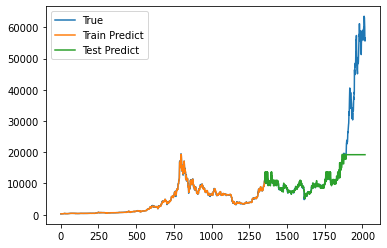

In [157]:
trainPredictPlot = numpy.empty(dataset.shape[0])
trainPredictPlot[:] = numpy.nan
trainPredictPlot[look_back_memory:len(trainPredict)+look_back_memory] = trainPredict

# y lo mismo para el test
testPredictPlot = numpy.empty(dataset.shape[0])
testPredictPlot[:] = numpy.nan
testPredictPlot[len(trainPredict)+(look_back_memory*2)+1:len(dataset)-1] = testPredict

# y mostramos los datos originales, la predicción en training y la predicción en test
plt.plot(scaler.inverse_transform(dataset), label='True')
plt.plot(trainPredictPlot, label='Train Predict')
plt.plot(testPredictPlot, label='Test Predict')
plt.legend()
plt.show()

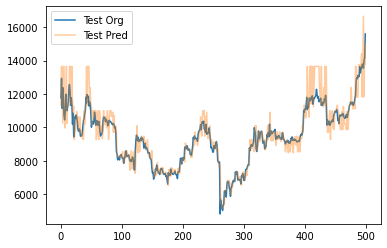

In [161]:
plt.plot(testY_orig[:500], label='Test Org')
plt.plot(testPredict[:500], label='Test Pred', alpha=0.4)
plt.legend()
plt.show()

In [159]:
testScore = math.sqrt(mean_squared_error(testY_orig[:500], testPredict[:500]))
print('Test Score: %.2f RMSE' % (testScore))

Test Score: 719.27 RMSE


### With Close And Halving

In [183]:
dataset_raw = pd.read_csv('df_indexes_gold_eth.csv', index_col=0)

In [184]:
dataset_raw.head()

,Open Time,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth
0,2015-10-11,246.3,249.50,246.30,249.50,3021.12,104550.0,2081.72,2077.19,1,1149.4,1149.4,17724.13,17758.21,0.60
1,2015-10-12,249.5,249.50,247.60,247.60,9493.89,134410.0,2052.23,2047.93,1,1130.3,1130.3,17493.17,17574.75,0.63
2,2015-10-13,247.6,252.87,245.75,250.00,12875.40,134878.0,2003.69,2015.00,1,1231.7,1231.7,17113.55,17081.89,0.60
3,2015-10-14,250.0,254.75,250.00,253.00,30115.77,141985.0,1994.24,2003.66,1,1243.6,1243.6,17079.08,16924.75,0.50
4,2015-10-15,253.0,258.98,253.00,255.26,50535.45,153495.0,2023.86,1996.47,1,1251.4,1251.4,16944.86,17141.75,0.56


In [189]:
dataset_raw.loc[dataset_raw['Open Time'] > '2016-07-09', 'halving']=3

In [193]:
dataset_raw.corr()

,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth
Open,1.000000,0.999305,0.998788,0.998617,0.026750,0.842397,0.774783,0.779131,0.281675,0.571550,0.575014,0.711572,0.707788,0.919708
High,0.999305,1.000000,0.998662,0.999427,0.032724,0.846551,0.773268,0.777527,0.280716,0.569323,0.572833,0.709733,0.706028,0.920838
Low,0.998788,0.998662,1.000000,0.999138,0.011956,0.835859,0.776226,0.780583,0.282468,0.574603,0.578147,0.712480,0.708726,0.918170
Close_btc,0.998617,0.999427,0.999138,1.000000,0.024030,0.842797,0.774551,0.778765,0.281272,0.571732,0.575210,0.710537,0.706894,0.920012
Volume,0.026750,0.032724,0.011956,0.024030,1.000000,-0.164348,-0.035034,-0.035626,0.194231,-0.152432,-0.152111,0.058259,0.058708,0.199310
NumberTransactions,0.842397,0.846551,0.835859,0.842797,-0.164348,1.000000,0.705674,0.709172,0.196898,0.639348,0.640950,0.589212,0.585307,0.717076
Close SP500,0.774783,0.773268,0.776226,0.774551,-0.035034,0.705674,1.000000,0.998829,0.525417,0.805762,0.806417,0.970832,0.971341,0.668378
Open SP500,0.779131,0.777527,0.780583,0.778765,-0.035626,0.709172,0.998829,1.000000,0.523759,0.805593,0.806334,0.971318,0.969457,0.672635
halving,0.281675,0.280716,0.282468,0.281272,0.194231,0.196898,0.525417,0.523759,1.000000,0.379820,0.379780,0.596472,0.597880,0.295621
Close Gold,0.571550,0.569323,0.574603,0.571732,-0.152432,0.639348,0.805762,0.805593,0.379820,1.000000,0.998549,0.694821,0.693893,0.433628


In [176]:
dataset_raw['Open Time'] = pd.to_datetime(dataset_raw[r'Open Time'])

In [177]:
dataset_raw = dataset_raw[['Close_btc', 'halving']]

In [192]:
dataset_raw[dataset_raw.halving==3]

,Open Time,Open,High,Low,Close_btc,Volume,NumberTransactions,Close SP500,Open SP500,halving,Close Gold,Open Gold,OpenDJ,CloseDJ,Close_eth
273,2016-07-10,654.78,654.78,640.40,649.99,3.274126e+05,162608.0,2153.74,2164.19,3,1304.5,1304.5,18295.35,18240.49,10.97
274,2016-07-11,649.99,658.99,645.00,650.83,6.773412e+05,218089.0,2131.52,2100.59,3,1340.4,1340.4,17994.64,18259.60,10.58
275,2016-07-12,650.83,674.83,647.73,673.99,1.200533e+06,219034.0,2241.35,2210.72,3,1250.6,1250.6,19241.99,19549.62,10.87
276,2016-07-13,673.99,673.99,657.02,661.55,1.001514e+06,216503.0,2152.43,2153.81,3,1399.0,1399.0,18356.78,18372.12,10.76
277,2016-07-14,661.55,663.48,650.67,658.98,9.127901e+05,217695.0,2163.75,2157.88,3,1387.7,1387.7,18414.30,18506.41,11.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014,2021-04-16,63158.74,63520.61,60000.00,61334.80,9.176414e+04,2639940.0,4185.47,4174.14,3,1779.0,1770.4,34058.16,34200.67,2422.67
2015,2021-04-17,61334.81,62506.05,59580.91,60006.66,5.891226e+04,2268816.0,4185.47,4174.14,3,1779.0,1770.4,34058.16,34200.67,2317.60
2016,2021-04-18,60006.67,60499.00,50931.30,56150.01,1.248821e+05,3444089.0,4185.47,4174.14,3,1779.0,1770.4,34058.16,34200.67,2235.64
2017,2021-04-19,56150.01,57526.81,54221.58,55633.14,7.822904e+04,2390527.0,4162.80,4175.60,3,1769.4,1782.1,34182.38,34077.63,2161.12


In [156]:
dataset_raw.values[0,:-1]

array([249.5])

In [157]:
np.append(dataset_raw.values[0, :-1], dataset_raw.values[1, -1])

array([249.5,   1. ])

In [158]:
def create_dataset(dataset):
    data = []
    for i in range(len(dataset)-1):
        data.append(np.append(dataset_raw.values[i, :], dataset_raw.values[i+1, -2]))
    return np.array(data)

data = create_dataset(dataset_raw.values)
print(data[:5])
print(data.shape)

[[249.5    1.   247.6 ]
 [247.6    1.   250.  ]
 [250.     1.   253.  ]
 [253.     1.   255.26]
 [255.26   1.   263.75]]
(2018, 3)


In [159]:
data = (data - data.min(axis=0)) / (data.max(axis=0) - data.min(axis=0))

In [160]:
from numpy import asarray
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.metrics import mean_absolute_error
from xgboost import XGBRegressor
from matplotlib import pyplot
import numpy
from tqdm import tqdm

# split a univariate dataset into train/test sets
def train_test_split(data, n_test):
	return data[:-n_test, :], data[-n_test:, :]

# fit an xgboost model and make a one step prediction
def xgboost_forecast(train, testX, n_estimators):
	# transform list into array
	train = asarray(train)
	# split into input and output columns
	trainX, trainy = train[:, :-1], train[:, -1]
	# fit model
	model = XGBRegressor(objective='reg:squarederror', n_estimators=n_estimators)
	model.fit(trainX, trainy)
	# make a one-step prediction
	yhat = model.predict(asarray([testX]))
	return yhat[0], model

# walk-forward validation for univariate data
def walk_forward_validation(data, n_test, n_estimators=10):
    predictions = list()
    models = list()
    # split dataset
    train, test = train_test_split(data, n_test)
    # seed history with training dataset
    history = [x for x in train]
    # step over each time-step in the test set
    for i in tqdm(range(len(test))):
        # split test row into input and output columns
        testX, testy = test[i, :-1], test[i, -1]
        # fit model on history and make a prediction
        yhat, model = xgboost_forecast(history, testX, n_estimators)
        # store forecast in list of predictions
        predictions.append(yhat)
        models.append(model)
        # add actual observation to history for the next loop
        history.append(test[i])
        # summarize progress
        # print('>expected=%.1f, predicted=%.1f' % (testy, yhat))
    # estimate prediction error
    error = mean_absolute_error(test[:, -1], predictions)
    return error, test[:, -1], predictions, models

100%|█████████████████████████████████████████████████████████████████████████████| 1760/1760 [00:12<00:00, 140.82it/s]


MAE: 0.013


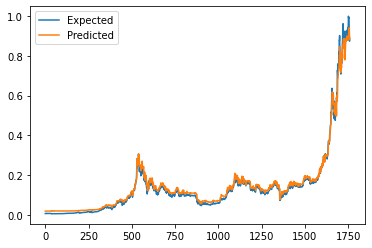

In [161]:
# evaluate
mae, y, yhat, models = walk_forward_validation(data, n_test=1760, n_estimators=10)
print('MAE: %.3f' % mae)
# plot expected vs preducted
pyplot.plot(y, label='Expected')
pyplot.plot(yhat, label='Predicted')
pyplot.legend()
pyplot.show()

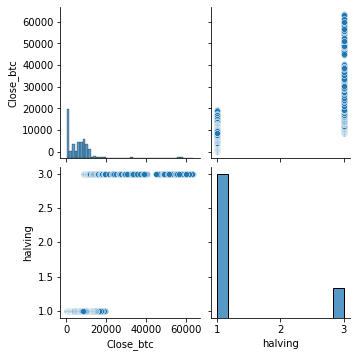

In [162]:
import seaborn as sns
sns.pairplot(dataset_raw)

In [163]:
cols = dataset_raw.columns
imps = numpy.stack([m.feature_importances_ for m in models])

In [164]:
cols

Index(['Close_btc', 'halving'], dtype='object')

In [165]:
imps.shape

(1760, 2)

In [166]:
feature_importances = DataFrame(imps, columns=cols)
# feature_importances = feature_importances.sort_values(by='imp',ascending=False)
# px.bar(feature_importances,x='col',y='imp')
feature_importances.describe()

,Close_btc,halving
count,1760.000000,1760.000000
mean,0.999866,0.000133
std,0.000451,0.000451
min,0.996049,0.000000
25%,1.000000,0.000000
50%,1.000000,0.000000
75%,1.000000,0.000000
max,1.000000,0.003951


In [167]:
!pip install shap

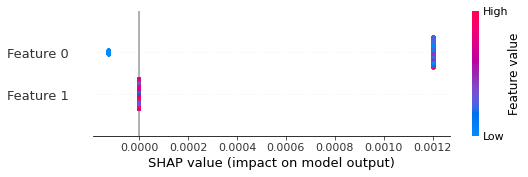

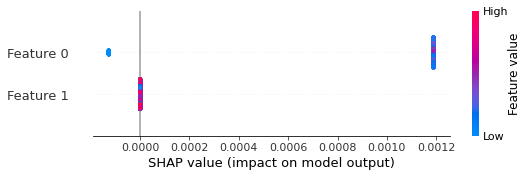

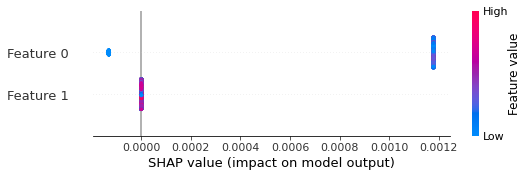

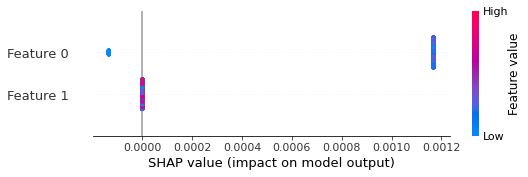

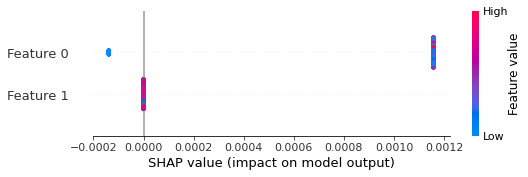

...

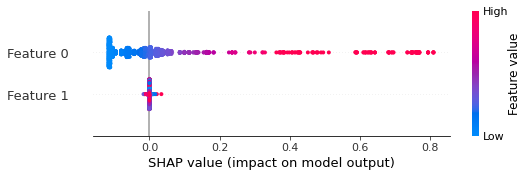

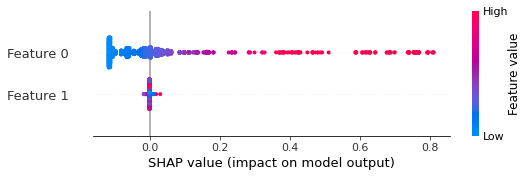

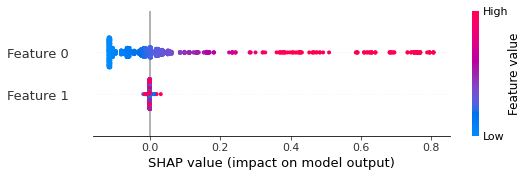

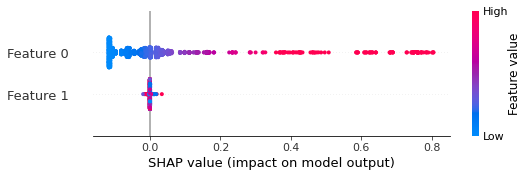

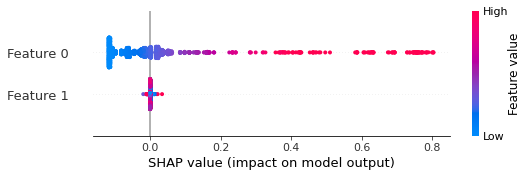

In [147]:
import shap
shap_values_list = []
for m in models:
    explainer = shap.TreeExplainer(m)
    shap_values = explainer.shap_values(data[:,:-1])
    shap.summary_plot(shap_values, data[:,:-1])

## LSTM

In [41]:
import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)

### With Close And Day of Year

In [42]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from pandas import read_csv
import math
from keras.models import Sequential
from keras.layers import Dense, LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

In [43]:
df_eth = pd.read_csv('df_indexes_gold_eth.csv')

In [44]:
df_eth['Open Time'] = pd.to_datetime(df_eth[r'Open Time'])

In [45]:
dataframe = df_eth[['Close_btc', 'Open Time']]
dataframe.head()

,Close_btc,Open Time
0,249.50,2015-10-11
1,247.60,2015-10-12
2,250.00,2015-10-13
3,253.00,2015-10-14
4,255.26,2015-10-15


In [46]:
dataframe['weekday'] = dataframe['Open Time'].dt.dayofweek

<ipython-input-46-502a9f29a6f7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['weekday'] = dataframe['Open Time'].dt.dayofweek


In [47]:
dataframe = dataframe[['Close_btc','weekday']]
dataframe.head()

,Close_btc,weekday
0,249.50,6
1,247.60,0
2,250.00,1
3,253.00,2
4,255.26,3


In [48]:
# ligeramente modificada para escoger la variable objetivo
def create_dataset(dataset, look_back_memory=1, idx_target=-1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back_memory-1):
        dataX.append(dataset[i:i+look_back_memory])
        dataY.append(dataset[i+look_back_memory, idx_target])
    return np.array(dataX), np.array(dataY)

In [49]:
np.random.seed(42)

# cargamos los datos
dataset = dataframe.values
dataset = dataset.astype('float32')

# normalizamos el dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset)

# dividimos en train y test
# train_size = int(len(dataset) * 0.67)
train_size = int(len(dataset) * 0.67)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

# transformamos los datos para crearnos N registros con T timestamps cada uno 
# (uno por cada instante temporal hasta completar el tamaño de la ventana) y 
# las V variables de las que disponga nuestro dataset. En este caso, vamos a 
# escoger una ventana con un único timestamp T=10 y solo tendremos una variable,
# con lo que V=1 (valor de cierre de la acción).
look_back_memory = 5
trainX, trainY = create_dataset(train, look_back_memory, 0)
testX, testY = create_dataset(test, look_back_memory)
print(trainX.shape, trainY.shape)
print(testX.shape, testY.shape)

(1346, 5, 2) (1346,)
(661, 5, 2) (661,)


In [50]:
variables = 2
trainX = np.reshape(trainX, (trainX.shape[0], look_back_memory, variables))
testX = np.reshape(testX, (testX.shape[0], look_back_memory, variables))
print(trainX.shape)
print(testX.shape)

(1346, 5, 2)
(661, 5, 2)


In [51]:
model = Sequential() #initialize model
model.add(LSTM(10, input_shape=(look_back_memory, variables)))
model.add(Dense(1, activation='linear'))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=20, batch_size=1, verbose=1)

Epoch 1/20
1346/1346 [==============================] - 8s 5ms/step - loss: 0.0023
Epoch 2/20
1346/1346 [==============================] - 5s 4ms/step - loss: 7.1666e-05
Epoch 3/20
1346/1346 [==============================] - 6s 4ms/step - loss: 7.0117e-05
Epoch 4/20
1346/1346 [==============================] - 6s 4ms/step - loss: 6.4251e-05
Epoch 5/20
1346/1346 [==============================] - 5s 4ms/step - loss: 6.8952e-05
Epoch 6/20
1346/1346 [==============================] - 5s 4ms/step - loss: 5.9337e-05
Epoch 7/20
1346/1346 [==============================] - 5s 4ms/step - loss: 6.3367e-05
Epoch 8/20
1346/1346 [==============================] - 5s 4ms/step - loss: 5.0294e-05
Epoch 9/20
1346/1346 [==============================] - 5s 4ms/step - loss: 6.2312e-05
Epoch 10/20
1346/1346 [==============================] - 5s 4ms/step - loss: 4.9639e-05
Epoch 11/20
1346/1346 [==============================] - 5s 4ms/step - loss: 5.0214e-05
Epoch 12/20
1346/1346 [======================

In [52]:
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

In [53]:
xmin = scaler.data_min_[-2]
xmax = scaler.data_max_[-2]
trainPredict = trainPredict * (xmax - xmin) + xmin
trainY_orig = trainY * (xmax - xmin) + xmin
testPredict = testPredict * (xmax - xmin) + xmin
testY_orig = testY * (xmax - xmin) + xmin

Train Score: 469.63 RMSE
Test Score: 29409.39 RMSE


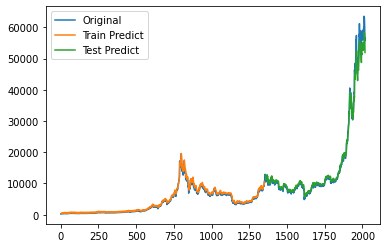

In [54]:
trainScore = math.sqrt(mean_squared_error(trainY_orig, trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY_orig, testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

# por como creamos el dataset de entrenamiento, ahora tenemos que desplazar
# nuestras predicciones para que "cuadren" con el eje x de los datos originales
trainPredictPlot = np.full(dataset.shape[0], np.nan)
trainPredictPlot[look_back_memory:len(trainPredict)+look_back_memory] = trainPredict[:, 0]

# y lo mismo para el test
testPredictPlot = np.full(dataset.shape[0], np.nan)
testPredictPlot[len(trainPredict)+(look_back_memory*2)+1:len(dataset)-1] = testPredict[:, 0]

# y mostramos los datos originales, la predicción en training y la predicción en test
plt.plot(df_eth['Close_btc'].values, label='Original')
plt.plot(trainPredictPlot, label='Train Predict')
plt.plot(testPredictPlot, label='Test Predict')
plt.legend()
plt.show()

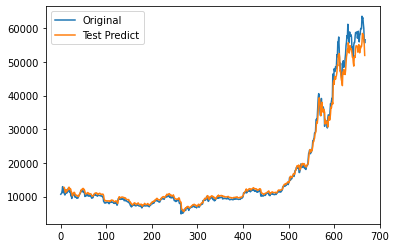

In [55]:
# y mostramos los datos originales, la predicción en training y la predicción en test
plt.plot(df_eth['Close_btc'].values[1350:], label='Original')
plt.plot(testPredictPlot[1350:], label='Test Predict')
plt.legend()
plt.show()